In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy.stats import mode
from collections import Counter
import scvi

sc.settings.verbosity = 3
sc.set_figure_params(figsize = [16, 12], color_map='viridis')
sc.logging.print_versions()

-----
anndata     0.10.4
scanpy      1.9.6
-----
PIL                         9.4.0
absl                        NA
anyio                       NA
arrow                       1.3.0
asttokens                   NA
attr                        23.2.0
attrs                       23.2.0
babel                       2.14.0
backcall                    0.2.0
brotli                      1.1.0
certifi                     2024.02.02
cffi                        1.16.0
chardet                     5.2.0
charset_normalizer          3.3.2
chex                        0.1.85
colorama                    0.4.6
comm                        0.2.1
contextlib2                 NA
cycler                      0.12.1
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.8.1
decorator                   5.1.1
defusedxml                  0.7.1
docrep                      0.3.2
etils                       1.5.2
exceptiongroup              1.2.0
executing                   2.0.1
fas

In [2]:
# use the latent space to run paga again
adata_crinier = sc.read_h5ad('C:/Users/hafsa/OneDrive - Imperial College London/PhD/Public datasets/NK studies datasets/adata_crinier_post_scvi.h5ad')

C:\Users\hafsa\AppData\Roaming\Python\Python39\site-packages\anndata\_core\anndata.py:1906: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [3]:
adata_crinier

AnnData object with n_obs × n_vars = 24296 × 12049
    obs: 'Sample', 'Study', 'Sequencing_depth', 'Organ', 'Cell labels', '_scvi_batch', '_scvi_labels', 'leiden'
    uns: 'Cell labels_colors', 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap'
    layers: 'scVI normalised'
    obsp: 'connectivities', 'distances'

In [4]:
adata_crinier.obs['Cell labels'].value_counts()

Cell labels
hNK_Bm1/ CD56 dim       16357
hNK_Bm3/ NK0             4423
hNK_Bm2/ CD56 bright     3238
Unknown                   278
Name: count, dtype: int64

In [5]:
# remove all unknown cells, as these were primarily low quality and might interfere with analysis
adata_crinier = adata_crinier[adata_crinier.obs['Cell labels'] != 'Unknown']
adata_crinier.var_names_make_unique()

C:\Users\hafsa\AppData\Roaming\Python\Python39\site-packages\anndata\_core\anndata.py:1906: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
C:\Users\hafsa\AppData\Roaming\Python\Python39\site-packages\anndata\_core\anndata.py:1906: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [6]:
sc.pp.normalize_total(adata_crinier, target_sum = 10e4)
sc.pp.log1p(adata_crinier)

normalizing counts per cell
    finished (0:00:00)


C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


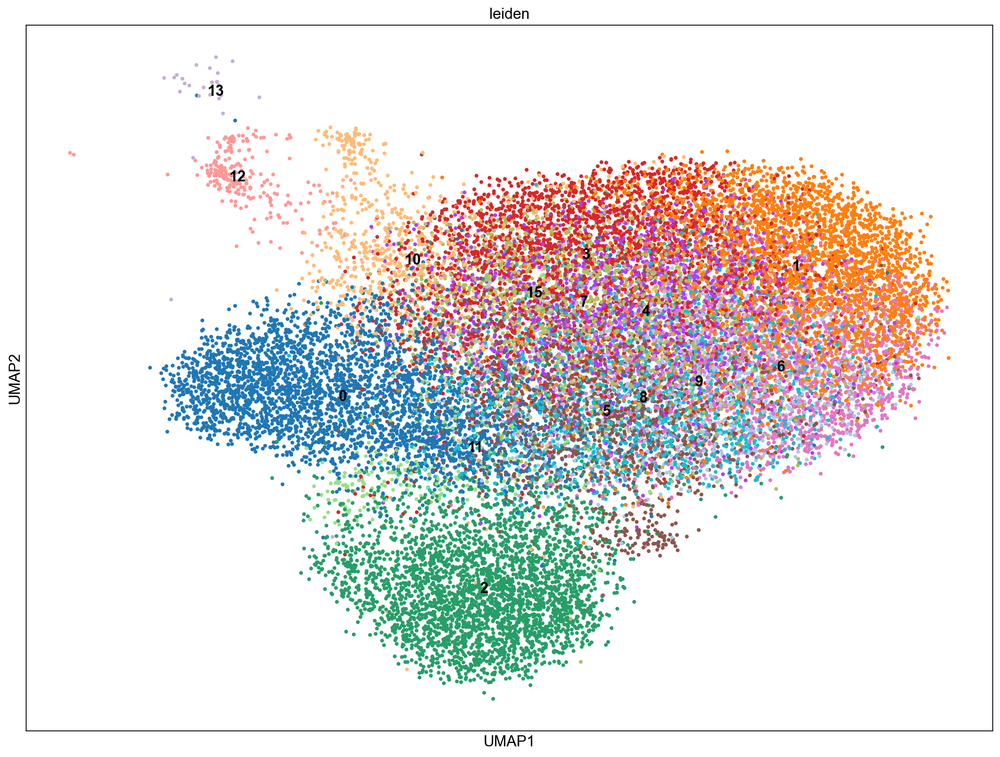

In [7]:
sc.pl.umap(adata_crinier, color = ['leiden'], s=50, legend_loc = 'on data')

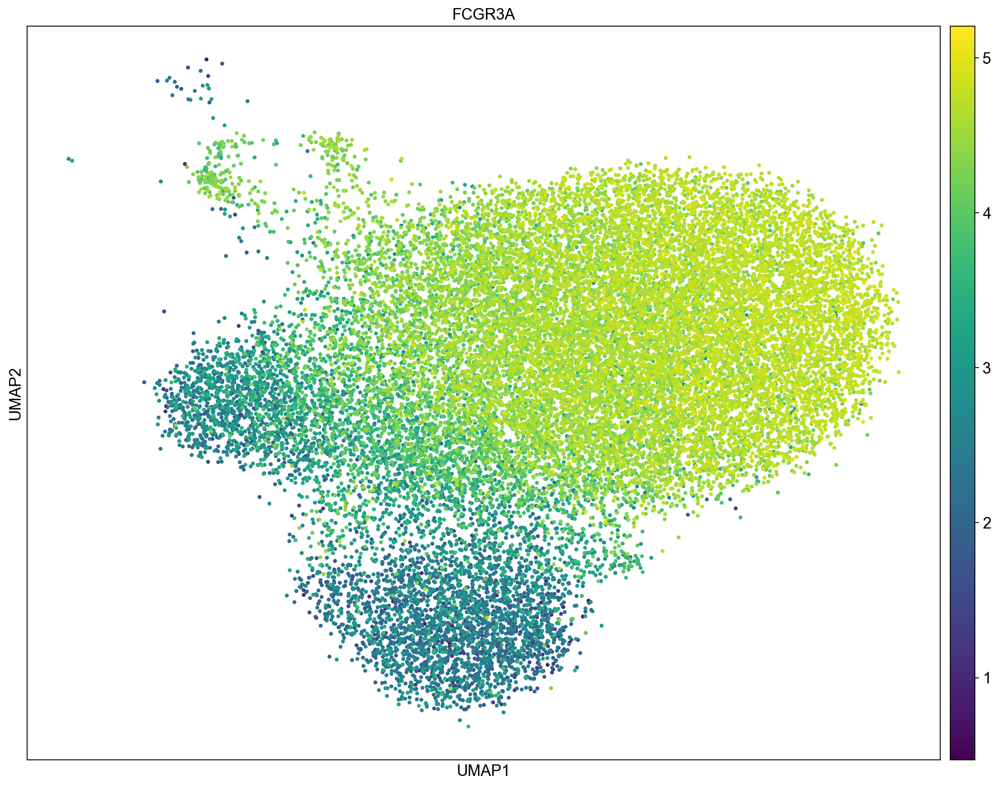

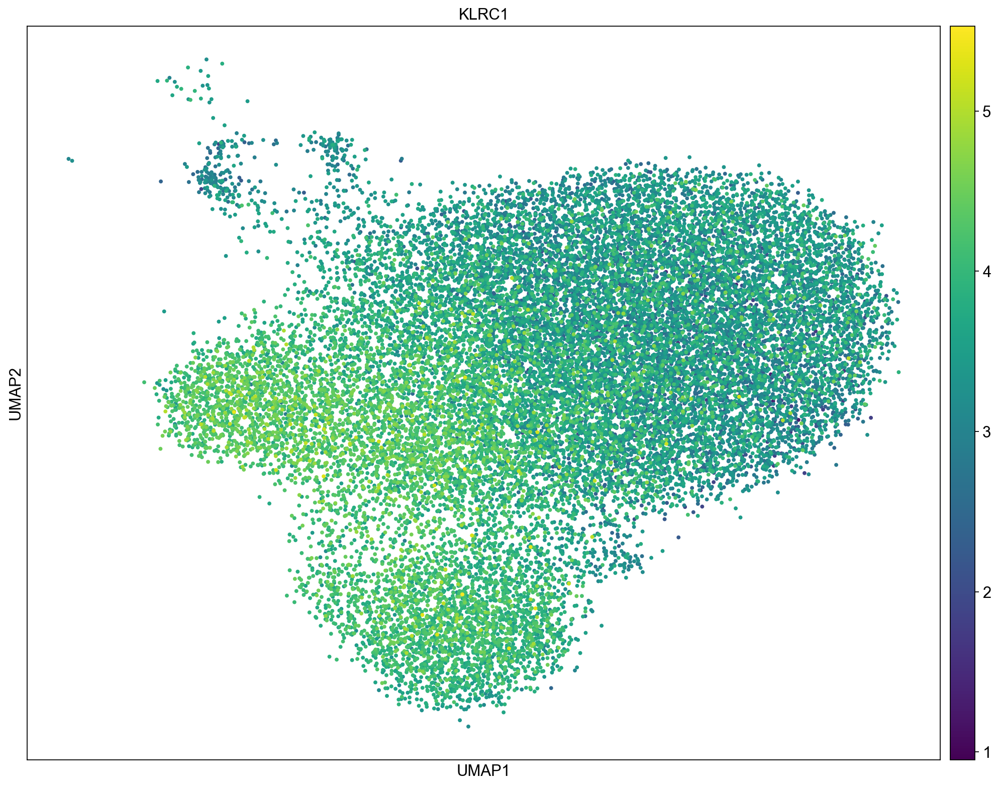

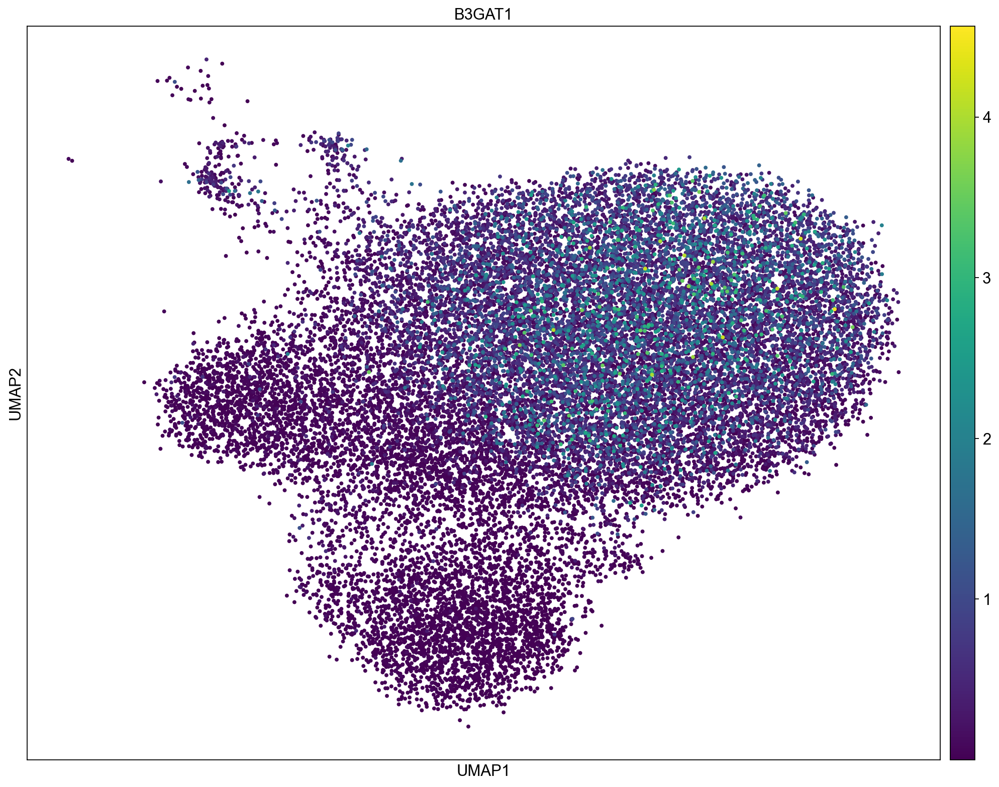

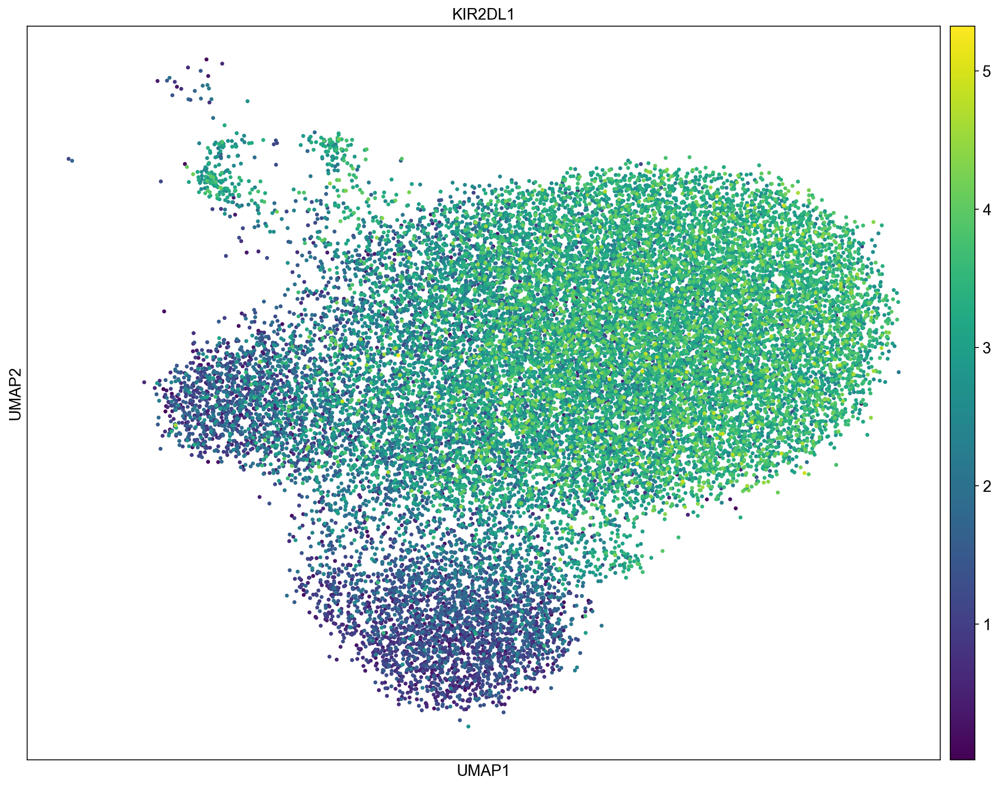

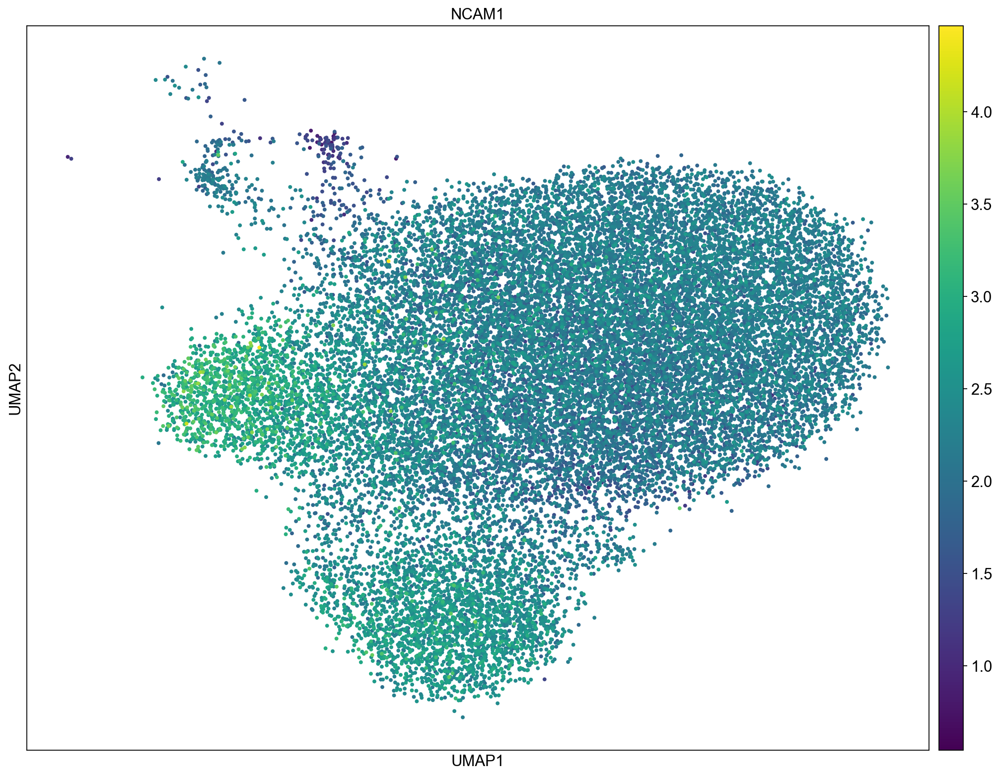

In [8]:
sc.pl.umap(adata_crinier, color = ['FCGR3A', ], s =50)
sc.pl.umap(adata_crinier, color = ['KLRC1', ], s =50)
sc.pl.umap(adata_crinier, color = ['B3GAT1', ], s =50)
sc.pl.umap(adata_crinier, color = ['KIR2DL1', ], s =50)
sc.pl.umap(adata_crinier, color = ['NCAM1', ], s =50)
# CD16, NKG2A, CD57, KIR
# NKG2A goes down in mature NK cells
# CD57, KIR goes up in mature NK cells

C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.con

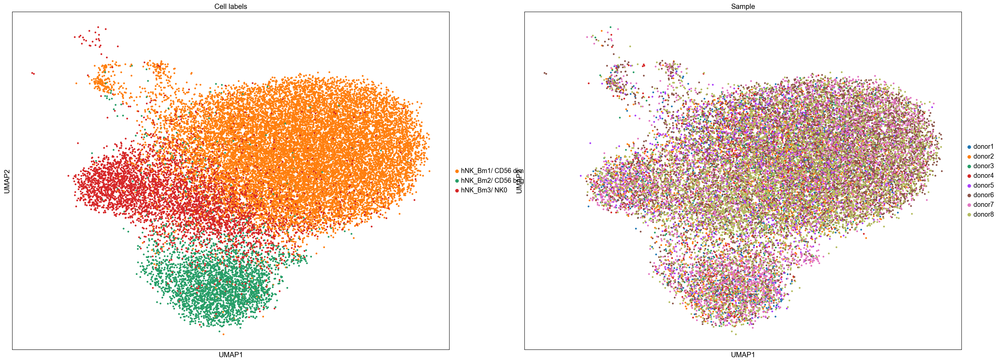

In [7]:
sc.pl.umap(adata_crinier, color = ['Cell labels', 'Sample'], s=50)

In [8]:
# compute graph using 20 pcs and 7 neighbors
# this is just a traditional approach can also use latent space to reduce dimensions
# tried pca, was terrible, use latent 

In [9]:
sc.tl.paga(adata_crinier, groups='leiden')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


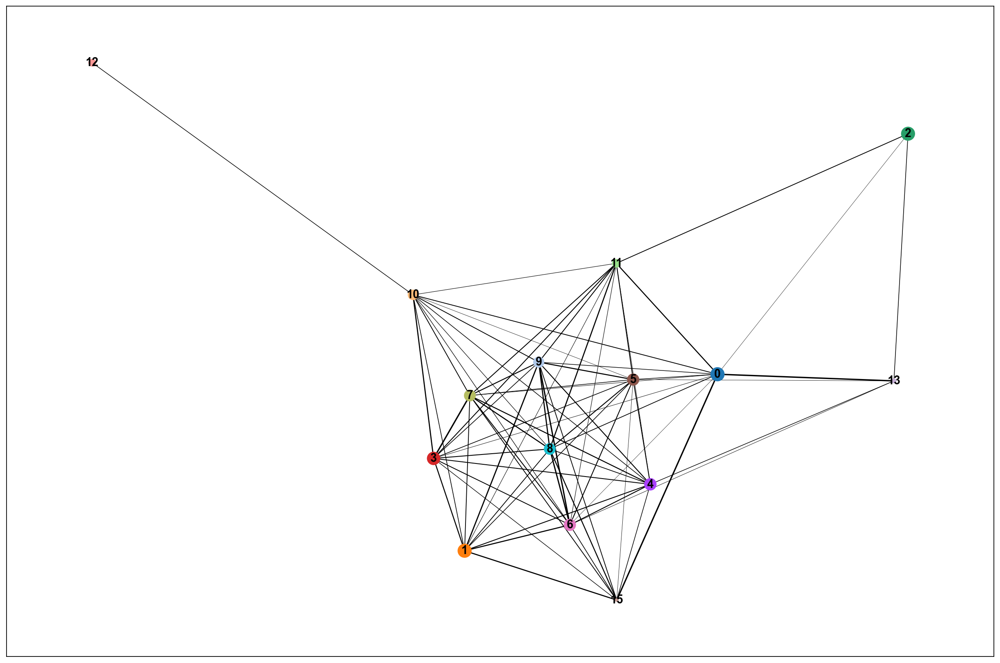

In [10]:
# this paga is grouped on leiden clusters
sc.pl.paga(adata_crinier, edge_width_scale=0.2, threshold=0.2)

In [11]:
# Clip a few outliers that extend far down the plot.
# sc.tl.umap(adata_crinier, init_pos = 'paga')
# adata_crinier.obsm['X_umap'][:, 1] = np.clip(adata_crinier.obsm['X_umap'][:, 1], a_min=-20, a_max=None)

C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.con

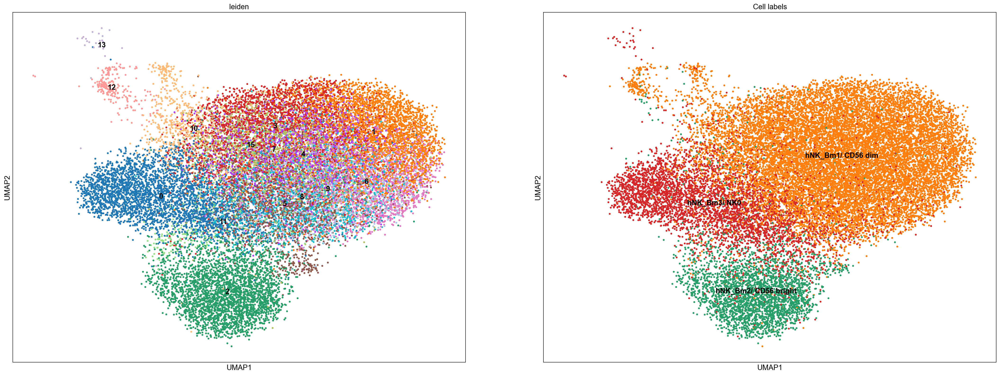

In [12]:
sc.pl.umap(adata_crinier, color=['leiden', 'Cell labels'], legend_loc='on data', s = 50)

C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


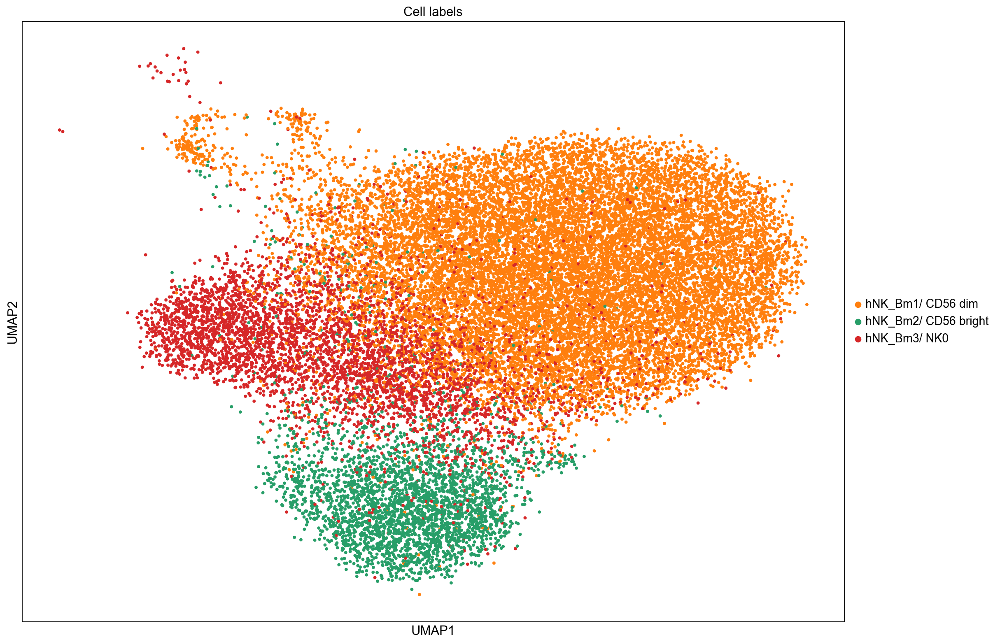

In [15]:
sc.pl.umap(adata_crinier, color=['Cell labels'],  s = 50)

C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


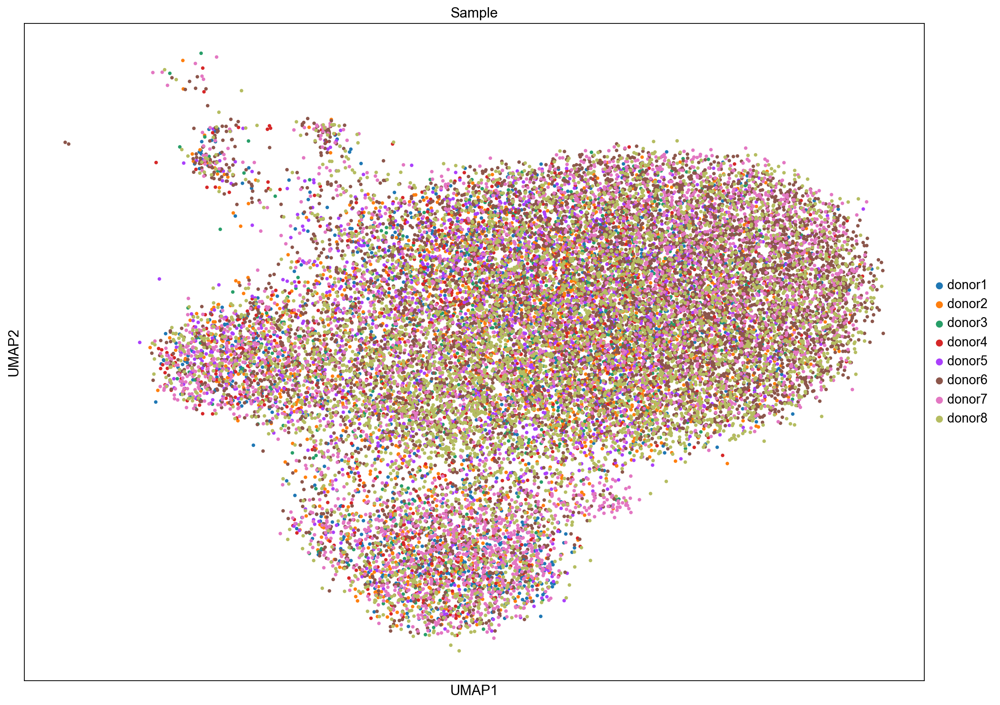

In [14]:
sc.pl.umap(adata_crinier, color=['Sample'], s = 50)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


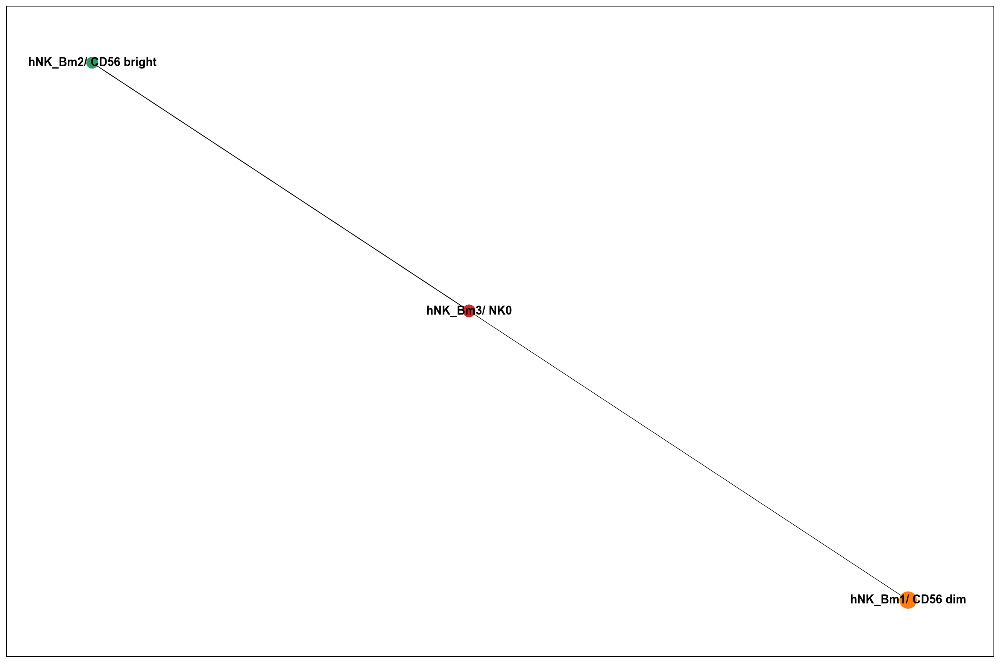

In [13]:
sc.tl.paga(adata_crinier, groups='Cell labels')
# this paga is grouped on Cell labels
sc.pl.paga(adata_crinier, edge_width_scale=0.2, threshold=0.2)

In [14]:
# the NK0 cells with highest NKP enrichment score as root

In [15]:
adata_crinier.obs_names.tolist().index('GCCTCTATCGTTTATC')

3039

In [19]:
adata_crinier.obs.iloc[3039]

Sample                         donor2
Study                   Crinier et al
Sequencing_depth    50,000 reads/cell
Organ                              BM
Cell labels              hNK_Bm3/ NK0
_scvi_batch                         1
_scvi_labels                        0
leiden                              0
dpt_pseudotime                    0.0
Name: GCCTCTATCGTTTATC, dtype: object

In [16]:
adata_crinier.uns['iroot'] = 3039

In [17]:
sc.tl.dpt(adata_crinier)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)


C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\neighbors\__init__.py:933: RuntimeWarning: divide by zero encountered in divide
  Q = scipy.sparse.spdiags(1.0 / q, 0, W.shape[0], W.shape[0])
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\neighbors\__init__.py:943: RuntimeWarning: divide by zero encountered in divide
  self.Z = scipy.sparse.spdiags(1.0 / z, 0, K.shape[0], K.shape[0])


    eigenvalues of transition matrix
    [ 1.          0.9674602   0.94671726  0.93313056  0.9307532   0.9084575
      0.89899766  0.8912233   0.8619949   0.8600634   0.84087855  0.83798933
     -0.85795015 -0.8897233  -0.9157836 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


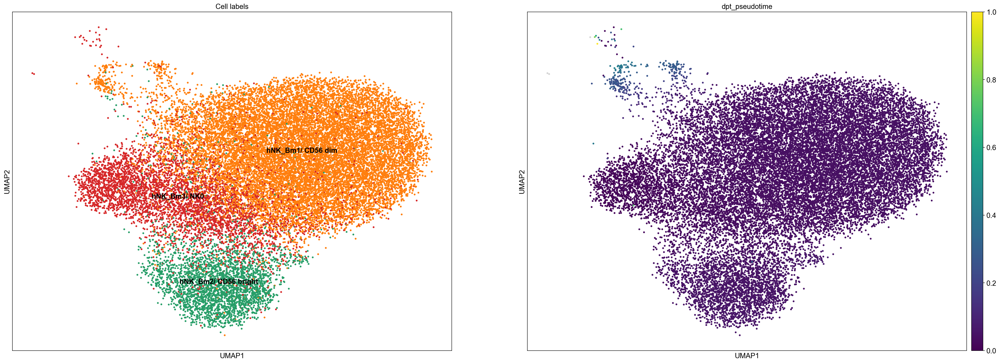

In [18]:
sc.pl.umap(adata_crinier, color=['Cell labels', 'dpt_pseudotime'], legend_loc='on data', s = 50)

--> added 'pos', the PAGA positions (adata.uns['paga'])


C:\Users\hafsa\.conda\envs\sc_env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


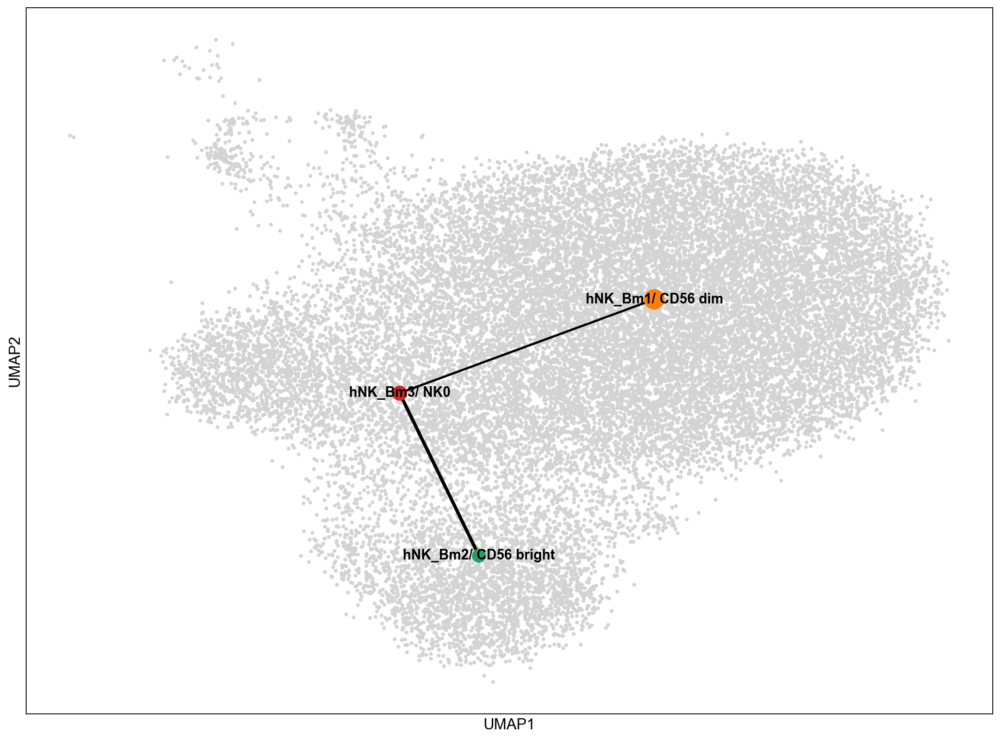

In [22]:
# Define PAGA positions based on the UMAP layout -
# for each cluster we use the mean of the UMAP positions from the cells in that cluster
pos = pd.DataFrame(adata_crinier.obsm["X_umap"], index=adata_crinier.obs_names)
pos["group"] = adata_crinier.obs[adata_crinier.uns["paga"]["groups"]]
pos = pos.groupby("group", observed=True).mean()

# Plot UMAP in the background
ax = sc.pl.umap(adata_crinier, show=False, s=50)
# Plot PAGA ontop of the UMAP
sc.pl.paga(
    adata_crinier,
    color="Cell labels",
    threshold=0.2,
    node_size_scale=1,
    edge_width_scale=0.7,
    pos=pos.values,
    random_state=0,
    ax=ax,
)

In [ ]:
# to contruct gene paths check tutorial online on the paga page